In [3]:
from tensorflow.keras.utils import load_img
from tensorflow.keras.models import load_model
from matplotlib import pyplot as plt
import matplotlib.image
import numpy as np
import cv2

2023-02-10 10:50:45.944468: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-10 10:50:46.197003: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-02-10 10:50:46.197022: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-02-10 10:50:47.002181: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-

# Load Model

We have trained several different models with different input sizes. You can select the model by the image dimension which the model is trained on.

In [5]:
SUB_IMAGE_LENGTH = 96

if SUB_IMAGE_LENGTH == 150:
    model = load_model('model_output/model_imgsize_150_epochs_15_02_09_2023_10_15_03')
elif SUB_IMAGE_LENGTH == 50:
    model = load_model('model_output/model_imgsize_50_epochs_15_02_09_2023_09_35_22')
elif SUB_IMAGE_LENGTH == 96:
    model = load_model('model_output/model_imgsize_50_epochs_30_LR_0.0001_BS_32_time_02_09_2023_15_19_07_PretrainedMobileNetV2_Flatten_4Dense_Dropout_Dense.h5') 


2023-02-10 10:50:50.704480: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/pbae/venv/cvi/lib/python3.10/site-packages/cv2/../../lib64:
2023-02-10 10:50:50.704503: W tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:265] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-10 10:50:50.704520: I tensorflow/compiler/xla/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (planck): /proc/driver/nvidia/version does not exist
2023-02-10 10:50:50.704910: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler 

# Helper Functions

In [6]:
def predict_cancer_probability(sub_image):
    pred = model.predict(sub_image, verbose=0)
    return pred[0][0]

def resize_image(image, size = 96):
    img = cv2.resize(image, (size,size))
    return img

In [8]:
image_iterator = list(range(0,im.shape[0]-SUB_IMAGE_LENGTH+1,SUB_IMAGE_LENGTH))

We load an sample image on which we run our cancer analysis.

In [4]:
image_name = "CRC-Prim-HE-05_APPLICATION"

im = load_img(f"data/large_images/{image_name}.tif")
im = np.array(im)

We loop over our "big" image and select a part of it. This sub image is then feed into our model which returns us the probabilities of all eight categories. We save the output of the probability that the sample is cancer in a matrix.

In [17]:
mask_image = np.zeros((im.shape[0], im.shape[1]))

for idx in image_iterator:
    for jdx in image_iterator:
        sub_image = im[idx:idx+SUB_IMAGE_LENGTH, jdx:jdx+SUB_IMAGE_LENGTH]
        if SUB_IMAGE_LENGTH == 96:
            sub_image = resize_image(sub_image, size=96)
        sub_image = np.expand_dims(sub_image, axis=0)
        pred = predict_cancer_probability(sub_image)
        mask_image[idx:idx+SUB_IMAGE_LENGTH, jdx:jdx+SUB_IMAGE_LENGTH] = pred



KeyboardInterrupt: 

Each entry in the mask-matrix represents the probability that the according sub-sample is cancer. E.g. if a pixel has a value close to 1, we are certain, that the image part contains cancer. Hence, if the value is close to 0, we assume, that there is no cancer present.

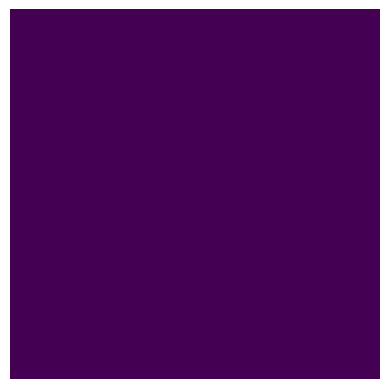

In [11]:
plt.figure()
plt.axis('off')
plt.imshow(mask_image)
plt.imsave('mask_image.png', mask_image)

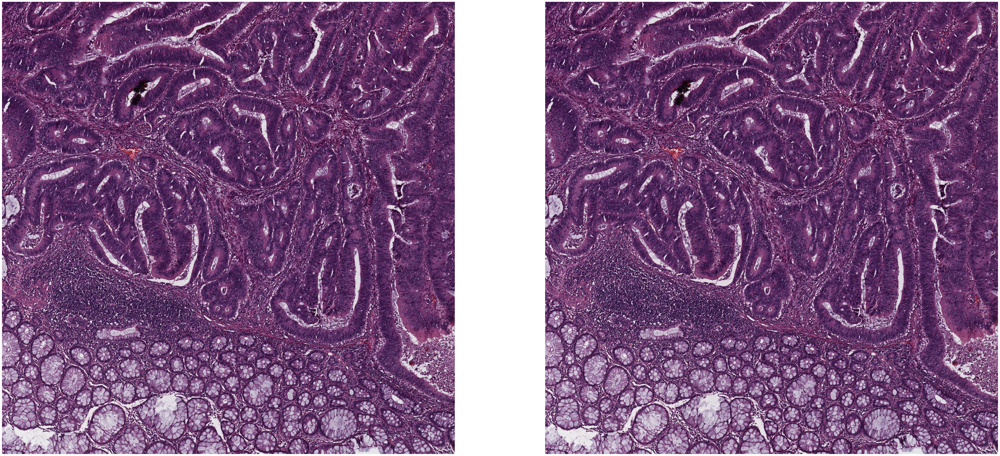

In [12]:
fig = plt.figure(figsize = (128,64))
plt.tight_layout()
plt.subplot(121)
plt.axis('off')
plt.imshow(im)
plt.subplot(122)
plt.axis('off')
plt.imshow(im)
plt.imshow(mask_image, alpha=mask_image, cmap = "Greens")
plt.savefig("output.png")

Repeat the procedure to all big images and save the output.

CRC-Prim-HE-09_APPLICATION


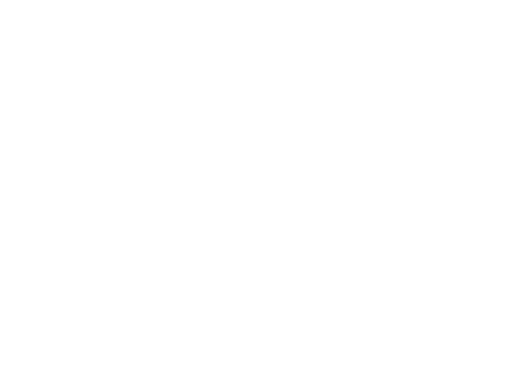

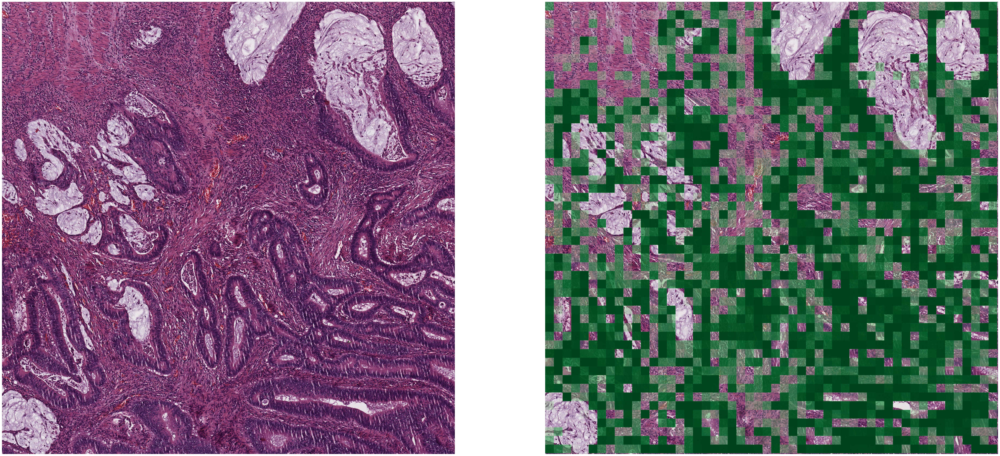

In [10]:
for idx in range(0,10,1):
    image_index = str(idx+1)
    if len(image_index) == 1:
        image_index = "0"+image_index
    image_name = f"CRC-Prim-HE-{image_index}_APPLICATION"

    print(image_name)

    im = load_img(f"data/large_images/{image_name}.tif")
    im = np.array(im)

    mask_image = np.zeros((im.shape[0], im.shape[1]))

    for idx in image_iterator:
        for jdx in image_iterator:
            sub_image = im[idx:idx+SUB_IMAGE_LENGTH, jdx:jdx+SUB_IMAGE_LENGTH]
            if SUB_IMAGE_LENGTH == 96:
                sub_image = resize_image(sub_image, size=96)
            sub_image = np.expand_dims(sub_image, axis=0)
            pred = predict_cancer_probability(sub_image)
            mask_image[idx:idx+SUB_IMAGE_LENGTH, jdx:jdx+SUB_IMAGE_LENGTH] = pred

    plt.figure()
    plt.axis('off')
    plt.imshow(mask_image)
    plt.imsave(f'mask_image_{image_index}.png', mask_image)

    fig = plt.figure(figsize = (64,32))
    plt.tight_layout()
    plt.subplot(121)
    plt.axis('off')
    plt.imshow(im)
    plt.subplot(122)
    plt.axis('off')
    plt.imshow(im)
    plt.imshow(mask_image, alpha=mask_image, cmap = "Greens")
    plt.savefig(f"output_{image_index}.png")